In [175]:
import pandas as pd
import numpy as np
from functools import reduce
import matplotlib.pyplot as plt


import pm4py
from pm4py.objects.log.importer.xes import importer as xes_importer
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.algo.discovery.inductive import algorithm as inductive_miner
from pm4py.algo.discovery.dfg import algorithm as dfg_algorithm
from pm4py.algo.filtering.log.attributes import attributes_filter
from pm4py.visualization.process_tree import visualizer as pt_vis
from pm4py.visualization.petri_net import visualizer as pn_visualizer
from pm4py.visualization.dfg import visualizer as dfg_vis_factory
from pm4py.visualization.bpmn import visualizer as bpmn_visualizer
from pm4py.objects.bpmn.importer import importer as bpmn_importer


from pm4py.algo.filtering.log.cases import case_filter


from pm4py.objects.log.util import dataframe_utils
from pm4py.algo.discovery.inductive.variants import im

from pm4py.objects.conversion.process_tree import converter as pt_converter
from pm4py.objects.conversion.bpmn import converter as bpmn_converter
from pm4py.algo.conformance.tokenreplay import algorithm as token_replay


from pm4py.algo.filtering.log.attributes import attributes_filter
from pm4py.algo.filtering.log.attributes.attributes_filter import Parameters as AttributesFilterParameters 

from pm4py.statistics.traces.generic.log import case_statistics
from pm4py.algo.discovery import performance_spectrum


from pm4py.objects.log.obj import EventLog, Trace, Event




import pm4py
import pandas as pd
import numpy as np
import os
from collections import defaultdict, Counter
from copy import deepcopy

# pm4py modules
from pm4py.objects.log.util import dataframe_utils
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.objects.log.importer.xes import importer as xes_importer
from pm4py.algo.discovery.inductive import algorithm as inductive_miner
from pm4py.visualization.petri_net import visualizer as pn_visualizer
from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.evaluation.precision import algorithm as precision_evaluator


from sklearn.tree import DecisionTreeClassifier, export_text
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

In [101]:
xes_path = "../data/BPI_Challenge_2019.xes"
log = xes_importer.apply(xes_path)

parsing log, completed traces ::   0%|          | 0/251734 [00:00<?, ?it/s]

In [102]:
print(f"✅ Loaded event log: {len(log)} cases, {sum(len(t) for t in log)} events")

✅ Loaded event log: 251734 cases, 1595923 events


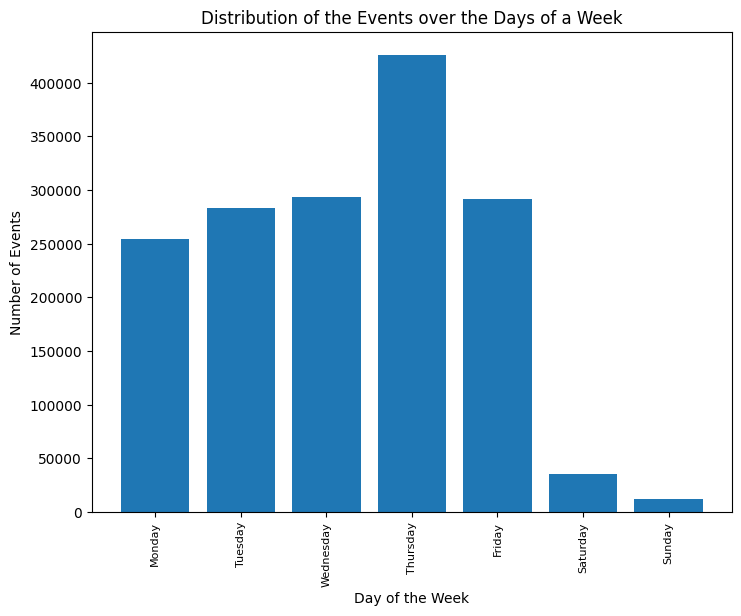

In [122]:
pm4py.view_events_distribution_graph(log, distr_type="days_week", format="png")

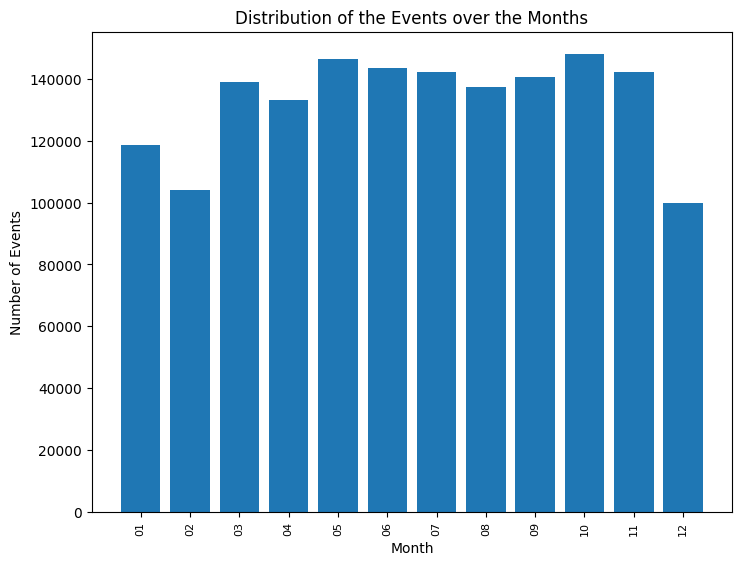

In [124]:
pm4py.view_events_distribution_graph(log, distr_type="months", format="png")

In [103]:
event_attrs = attributes_filter.get_all_event_attributes_from_log(log)
case_attrs = attributes_filter.get_all_trace_attributes_from_log(log)

print("Case attributes : \n", case_attrs)
print("Event attributes: \n", event_attrs)

Case attributes : 
 {'GR-Based Inv. Verif.', 'Goods Receipt', 'Purch. Doc. Category name', 'Sub spend area text', 'Source', 'Spend area text', 'Company', 'Item Category', 'Item', 'Name', 'Document Type', 'Vendor', 'Spend classification text', 'Purchasing Document', 'Item Type'}
Event attributes: 
 {'Cumulative net worth (EUR)', 'concept:name', 'org:resource', 'User', 'time:timestamp'}


In [97]:
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery
from pm4py.visualization.dfg import visualizer as dfg_visualizer


dfg = dfg_discovery.apply(log)
gviz = dfg_visualizer.apply(dfg, log=log, variant=dfg_visualizer.Variants.FREQUENCY)
dfg_visualizer.save(gviz, 'dfg_visualization.png')

''

In [104]:
attr_name = "concept:name"
activities_vs_freq_dict = attributes_filter.get_attribute_values(log, attr_name)
# print("All possible activities with freq:")
# activities_vs_freq_dict

In [105]:
print("All possible activities with freq:")
sorted_activities_vs_freq_dict = {key: value for key, value in sorted(activities_vs_freq_dict.items(), key=lambda item: item[1])}
display(sorted_activities_vs_freq_dict)

All possible activities with freq:


{'Change Rejection Indicator': 2,
 'SRM: Incomplete': 6,
 'SRM: Held': 6,
 'Change payment term': 7,
 'SRM: Transaction Completed': 8,
 'Change Final Invoice Indicator': 11,
 'Change Currency': 35,
 'SRM: Transfer Failed (E.Sys.)': 45,
 'Set Payment Block': 124,
 'Record Subsequent Invoice': 167,
 'SRM: Deleted': 188,
 'Update Order Confirmation': 244,
 'Change Storage Location': 415,
 'Release Purchase Requisition': 467,
 'Cancel Subsequent Invoice': 491,
 'Block Purchase Order Item': 514,
 'Reactivate Purchase Order Item': 543,
 'SRM: Change was Transmitted': 1440,
 'Release Purchase Order': 1610,
 'SRM: Created': 1628,
 'SRM: Complete': 1628,
 'SRM: Awaiting Approval': 1628,
 'SRM: Document Completed': 1628,
 'SRM: Ordered': 1628,
 'SRM: In Transfer to Execution Syst.': 1765,
 'Cancel Goods Receipt': 3096,
 'Change Delivery Indicator': 3289,
 'Vendor creates debit memo': 6255,
 'Cancel Invoice Receipt': 7096,
 'Change Approval for Purchase Order': 7541,
 'Delete Purchase Order Item'

In [106]:
item_categories = attributes_filter.get_trace_attribute_values(log, "Item Category")
print("Unique 'Item Category' values with counts:")
for category, count in item_categories.items():
    print(f"{category}: {count}")

Unique 'Item Category' values with counts:
3-way match, invoice before GR: 221010
3-way match, invoice after GR: 15182
Consignment: 14498
2-way match: 1044


In [113]:
categories = list(item_categories.keys())
counts = list(item_categories.values())

sorted_data = sorted(zip(categories, counts), key=lambda x: x[1], reverse=True)
categories, counts = zip(*sorted_data)

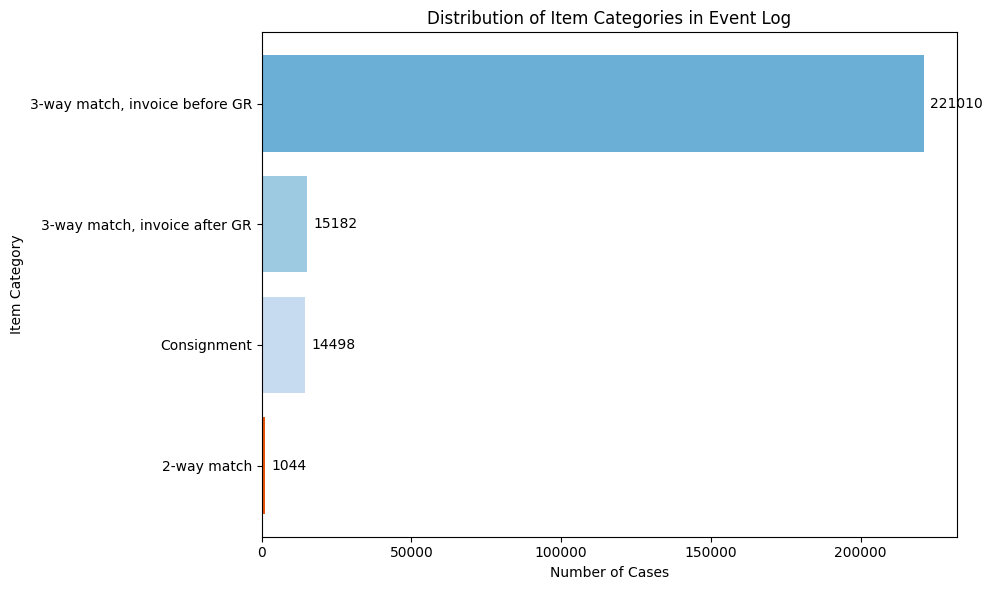

In [114]:
plt.figure(figsize=(10, 6))
plt.barh(categories, counts, color=['#6baed6', '#9ecae1', '#c6dbef', '#e6550d'])
plt.xlabel("Number of Cases")
plt.ylabel("Item Category")
plt.title("Distribution of Item Categories in Event Log")
plt.gca().invert_yaxis()  # Largest on top

# Annotate bars with values
for i, v in enumerate(counts):
    plt.text(v + max(counts)*0.01, i, str(v), va='center')

plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

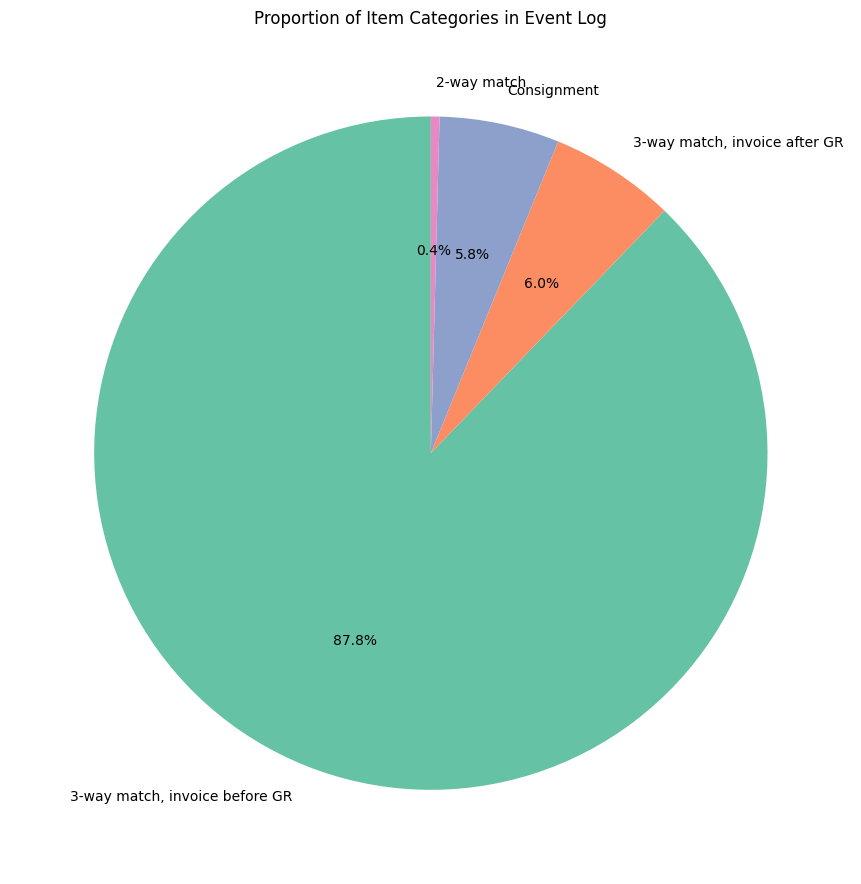

In [125]:
plt.figure(figsize=(9, 9))
plt.pie(
    counts,
    labels=categories,
    autopct='%1.1f%%',
    startangle=90,
    colors=['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3']
)
plt.title("Proportion of Item Categories in Event Log")
plt.tight_layout()
plt.show()

In [73]:
categories_to_logs = {}
attribute_key = "Item Category"

for category in item_categories.keys():
    allowed_values = [category]
    filter_parameters = {
        AttributesFilterParameters.ATTRIBUTE_KEY: attribute_key,
        AttributesFilterParameters.POSITIVE: True
    }
    filtered_log = attributes_filter.apply_trace_attribute(log, allowed_values, parameters=filter_parameters)
    categories_to_logs[category] = filtered_log
    print(f"Filtered log for category '{category}' created. Number of cases: {len(filtered_log)}")

Filtered log for category '3-way match, invoice before GR' created. Number of cases: 221010
Filtered log for category '3-way match, invoice after GR' created. Number of cases: 15182
Filtered log for category 'Consignment' created. Number of cases: 14498
Filtered log for category '2-way match' created. Number of cases: 1044


In [74]:
categories_to_logs.keys()

dict_keys(['3-way match, invoice before GR', '3-way match, invoice after GR', 'Consignment', '2-way match'])

In [75]:
type(categories_to_logs['3-way match, invoice before GR'])

pm4py.objects.log.obj.EventLog

##### White blocks with text (activity boxes)
##### Black squares (operators / connectors) = sequencing, choice, or loops
##### White circles = operator type


![Image](https://miro.medium.com/v2/resize:fit:1400/format:webp/1*UqoIvjKHjFDkxcJYPk9u4w.png)

[Info] Visualizing discovered Petri net...


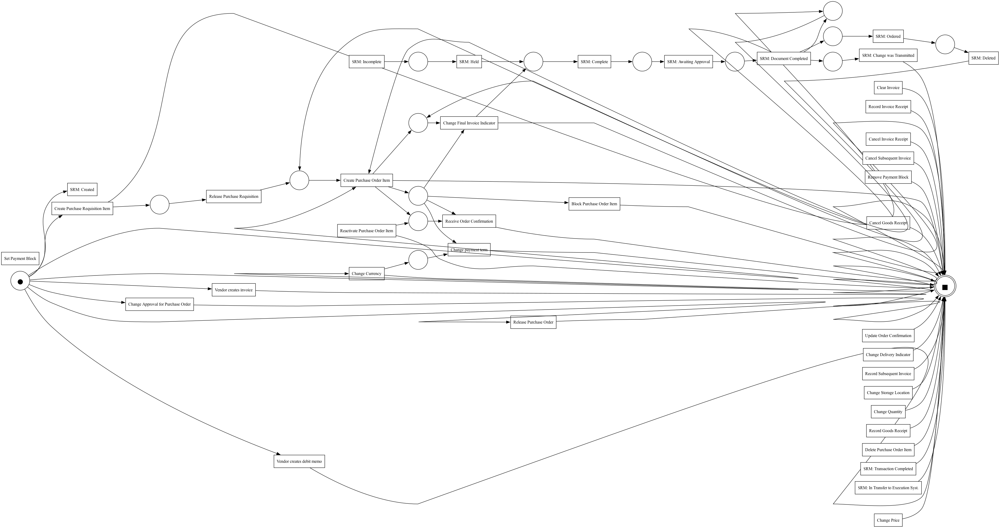

[Info] Visualizing discovered Petri net...


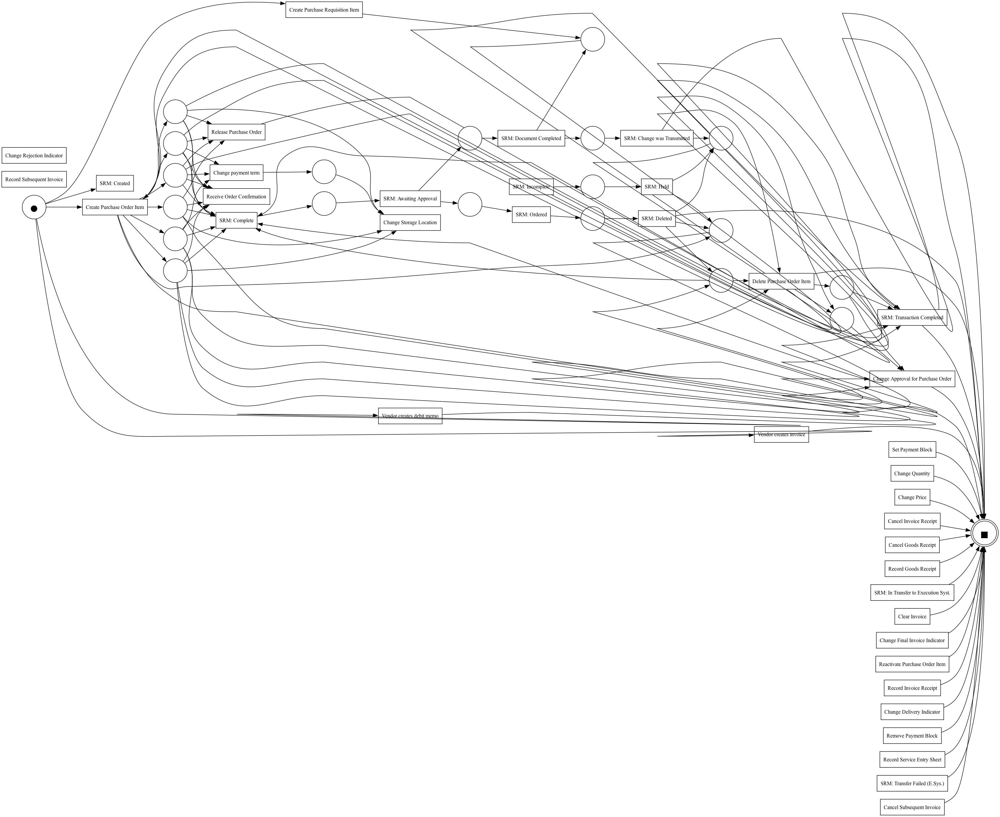

[Info] Visualizing discovered Petri net...


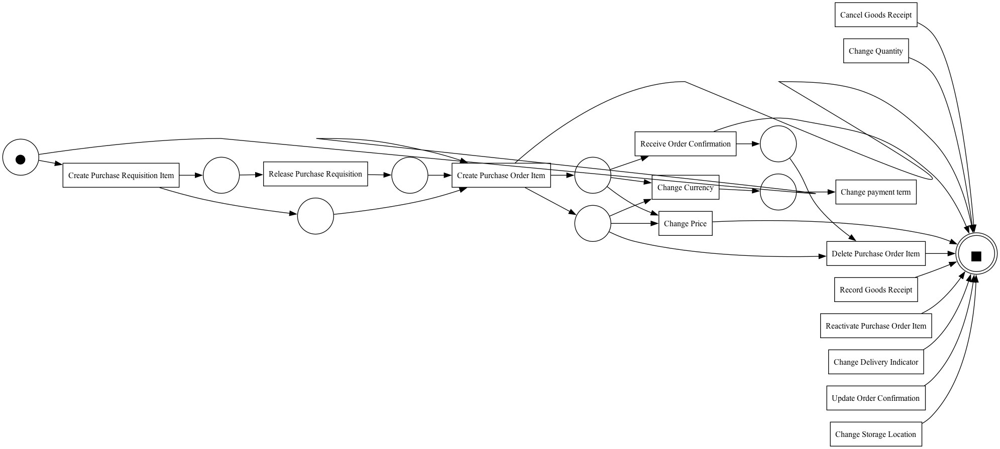

[Info] Visualizing discovered Petri net...


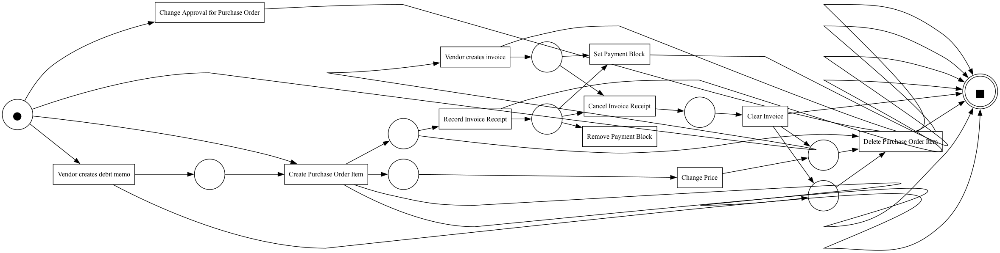

In [90]:
models = {}

for category, sub_log in categories_to_logs.items():

    net, initial_marking, final_marking = alpha_miner.apply(sub_log)
    models[category] = (net, initial_marking, final_marking)
    print(f"[Info] Visualizing discovered Petri net...")
    gviz = pn_visualizer.apply(net, initial_marking, final_marking)
    pn_visualizer.view(gviz)


 Discovering Process Tree model for: 3-way match, invoice before GR


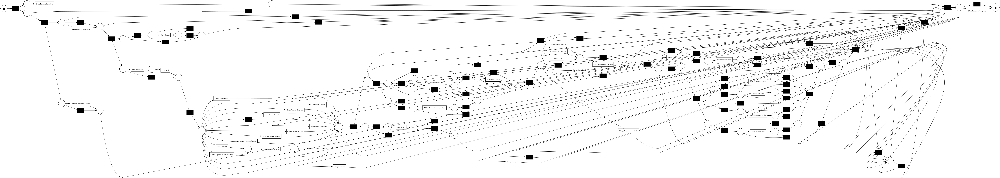


 Discovering Process Tree model for: 3-way match, invoice after GR


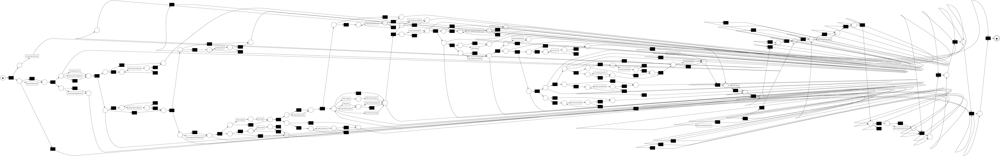


 Discovering Process Tree model for: Consignment


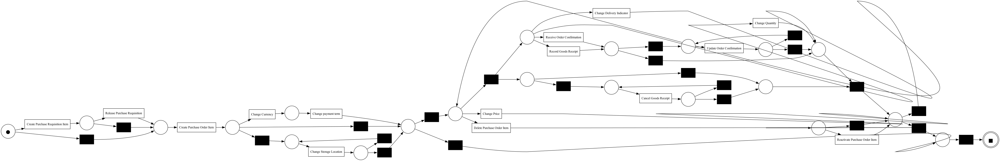


 Discovering Process Tree model for: 2-way match


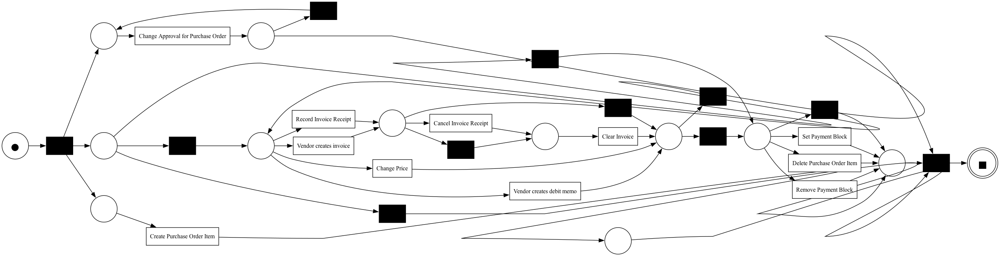

In [77]:
models = {}
for category, sub_log in categories_to_logs.items():
    print(f"\n Discovering Process Tree model for: {category}")
    params = {"noise_threshold": 0.5}
    # tree = inductive_miner.apply(sub_log, variant=inductive_miner.Variants.IM)
    tree = inductive_miner.apply(sub_log, variant=inductive_miner.Variants.IM, parameters=params)
    # tree = alpha_miner.apply(sub_log, variant=alpha_miner.Variants.ALPHA_VERSION_CLASSIC)
    net, initial_marking, final_marking = pt_converter.apply(tree)
    models[category] = (net, initial_marking, final_marking)
    gviz = pn_visualizer.apply(net, initial_marking, final_marking)
    pn_visualizer.view(gviz)

In [80]:
# White Rectangles with Text BPMN activities
# Diamonds with Symbols = BPMN gateways, used for routing (decision points, parallel splits, etc.).
#     X (or nothing)	Exclusive Gateway (XOR)	Only one outgoing path is taken (e.g., "approve OR reject")
#     +	Parallel Gateway (AND)	All outgoing paths are taken in parallel
#     O or blank circle	Inclusive Gateway (OR) (rare)	One or more paths may be taken
#     Looping arrows	Loop Marker	Repetition or loop (not always shown in PM4Py BPMN)


 Discovering BPMN model for: 3-way match, invoice before GR


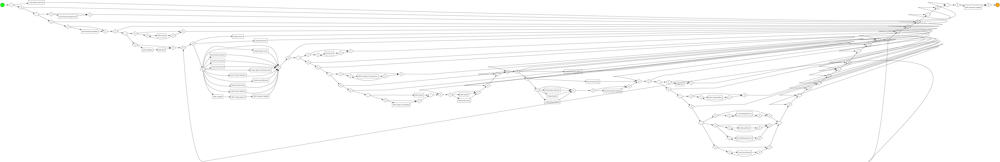


 Discovering BPMN model for: 3-way match, invoice after GR



 Discovering BPMN model for: Consignment


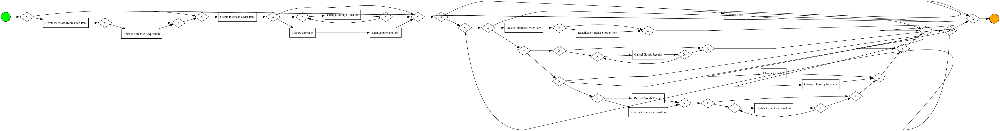


 Discovering BPMN model for: 2-way match


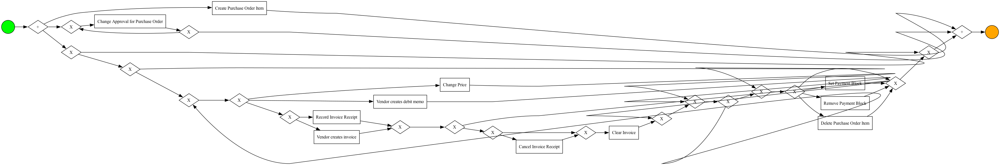

In [81]:
for category, sub_log in categories_to_logs.items():
    print(f"\n Discovering BPMN model for: {category}")
    tree = inductive_miner.apply(sub_log, variant=inductive_miner.Variants.IM)
    bpmn_graph = pm4py.objects.conversion.process_tree.variants.to_bpmn.apply(tree, parameters=None)
    gviz = bpmn_visualizer.apply(bpmn_graph)
    bpmn_visualizer.view(gviz)
    # bpmn_visualizer.save(gviz, f"bpmn_model_{category}.png")


In [91]:
# replay_result contain?
# - list of dictionaries, 
# - 1 dictionary per case/trace in event log, each containing like:
#     trace_fitness: How well the trace fits the model (between 0 and 1, where 1 is perfect fit)
#     tokens_consumed: Number of tokens consumed during replay
#     tokens_produced: Number of tokens produced
#     missing_tokens: Tokens that were expected by the model but missing in the log (indicates deviations)
#     remaining_tokens: Tokens left in the model after replay (also indicates deviations)


# Token Replay is log-fitting by design
conformance_results = []

for item_type, (net, im, fm) in models.items():
    filtered_log = categories_to_logs[item_type]
    replayed = token_replay.apply(filtered_log, net, im, fm)
    fitness_scores = [r['trace_fitness'] for r in replayed]
    avg_fitness = np.mean(fitness_scores)
    conformance_results.append((item_type, avg_fitness))

conformance_df = pd.DataFrame(conformance_results, columns=["Item Type", "Avg Fitness"])
display(conformance_df)

replaying log with TBR, completed traces ::   0%|          | 0/7832 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/4228 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/281 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/148 [00:00<?, ?it/s]

,Item Type,Avg Fitness
0,"3-way match, invoice before GR",0.354205
1,"3-way match, invoice after GR",0.341816
2,Consignment,0.463139
3,2-way match,0.332786


#### Inductive Miner
##### Properties
- Soundness
    - All discovered models are sound.
        - No deadlocks, livelocks, or unreachable states.

- Fitness:
        - Always fits the event log used for discovery.
        - Can replay all original traces without error.

##### Implication
- Models generated by Inductive Miner will have:
	- Fitness close to 1.0 on the input log


- Overfitting Risk = not generalize to unseen or future behavior
- Tends to memorize the event log structure



| Algorithm        | Sound | Fits Log | Overfitting |
|------------------|:-----:|:--------:|:-----------:|
| Inductive Miner  | Yes   | Always   | High        |
| Heuristics Miner | No    | Usually  | Moderate    |
| Alpha Miner      | No    | Partial  | Low         |
| Fuzzy Miner      | No    | Approx.  | High        |


In [ ]:
# ------------------------------------------------------------
# Compliance Rules
# ------------------------------------------------------------
# Rules implemented:
# 1. Payment block removed without being recorded
# 2. Invoice cleared before Goods Receipt (3-way match)
# 3. Invoice cleared without recording invoice

def check_payment_block_removed_without_record(trace):
    """Returns True if payment block removed but no 'Set Payment Block' appeared before."""
    block_set = False
    for e in trace:
        act = e["concept:name"]
        if "Set Payment Block" in act:
            block_set = True
        if "Remove Payment Block" in act and not block_set:
            return True
    return False


def check_invoice_cleared_before_goods(trace):
    """For 3-way match items, detect if Invoice Cleared occurred before Goods Receipt."""
    seen_goods = False
    for e in trace:
        act = e["concept:name"]
        if "Goods Receipt" in act:
            seen_goods = True
        if "Clear Invoice" in act and not seen_goods:
            return True
    return False


def check_invoice_cleared_without_invoice(trace):
    """Detect if invoice was cleared without ever being recorded."""
    has_invoice = any("Record Invoice" in e["concept:name"] for e in trace)
    has_cleared = any("Clear Invoice" in e["concept:name"] for e in trace)
    return has_cleared and not has_invoice

In [ ]:
rules_summary = {
    "Payment block removed w/o recording": 0,
    "Invoice cleared before goods": 0,
    "Invoice cleared w/o invoice": 0
}

for trace in log:
    if check_payment_block_removed_without_record(trace):
        rules_summary["Payment block removed w/o recording"] += 1
    if check_invoice_cleared_before_goods(trace):
        rules_summary["Invoice cleared before goods"] += 1
    if check_invoice_cleared_without_invoice(trace):
        rules_summary["Invoice cleared w/o invoice"] += 1

print("\n Compliance Violations Summary:")
for rule, count in rules_summary.items():
    print(f"- {rule:<40}: {count}")

In [ ]:
case_durations = case_statistics.get_all_case_durations(log, parameters={"timestamp_key": "time:timestamp"})
durations_df = pd.DataFrame(case_durations, columns=["case_duration_ms"])
durations_df["case_duration_days"] = durations_df["case_duration_ms"] / (1000 * 60 * 60 * 24)

plt.figure(figsize=(8,4))
plt.hist(durations_df["case_duration_days"], bins=50, color="steelblue", edgecolor="black")
plt.xlabel("Case Duration (days)")
plt.ylabel("Frequency")
plt.title("Throughput Time Distribution (BPI 2019 Procurement)")
plt.show()

print(f"Average throughput time: {durations_df['case_duration_days'].mean():.2f} days")

In [84]:
NOISE_THRESHOLD = 0.20            # 20% noise filtering used in the paper
MIN_CASES_PER_CLUSTER = 100      # skip clusters smaller than this (adjust as needed)
ACTIVITY_FREQ_THRESHOLD = 0.10   # remove activities seen in <10% of cluster traces

In [85]:
# detect common case attributes ----------
case_attrs = set()
for tr in log:
    case_attrs.update(tr.attributes.keys())

print("Detected case attributes (sample):", list(case_attrs)[:30])

def detect_case_attr(candidates):
    for c in candidates:
        if c in case_attrs:
            return c
    return None

# Candidate names frequently seen in BPI logs
po_category_candidates = ["item_category", "Item Category", "itemType", "Item Type", "po_category", "item_category:group"]
item_type_candidates = ["item_type", "itemType", "Item Type", "Item Category", "item_category"]
vendor_candidates = ["VendorID"]

po_attr = detect_case_attr(po_category_candidates)
item_attr = detect_case_attr(item_type_candidates)
vendor_attr = detect_case_attr(vendor_candidates)

print("Using PO attribute:", po_attr)
print("Using item attribute:", item_attr)
print("Using vendor attribute:", vendor_attr)

def trace_has_srm(trace):
    # "SRM:" prefix (case-insensitive)
    for e in trace:
        name = str(e.get("concept:name", "")).strip()
        if name.lower().startswith("srm:") or name.startswith("SRM:"):
            return True
    return False

def get_case_attr(trace, attr_name, default="UNKNOWN"):
    if not attr_name:
        return default
    return trace.attributes.get(attr_name, default)

Detected case attributes (sample): ['Name', 'Spend area text', 'Vendor', 'Sub spend area text', 'Spend classification text', 'Document Type', 'Company', 'Purch. Doc. Category name', 'Item Type', 'Item', 'GR-Based Inv. Verif.', 'Item Category', 'concept:name', 'Source', 'Goods Receipt', 'Purchasing Document']
Using PO attribute: Item Category
Using item attribute: Item Type
Using vendor attribute: None


In [86]:
# cluster key for each trace
clusters = defaultdict(list)  # key -> list of trace indices
for idx, tr in enumerate(log):
    po_val = get_case_attr(tr, po_attr, "ALL")
    it_val = get_case_attr(tr, item_attr, "ALL")
    srm_flag = "SRM" if trace_has_srm(tr) else "NO_SRM"
    # cluster key combining these three dimensions
    key = (str(po_val), srm_flag, str(it_val))
    clusters[key].append(idx)

# Filter clusters to those large enough and sort by size
cluster_sizes = sorted([(k, len(v)) for k, v in clusters.items()], key=lambda x: x[1], reverse=True)
print("Found clusters (key -> size) sample (top 20):")
for k, s in cluster_sizes[:20]:
    print(f"{k} -> {s}")

selected_clusters = [(k, idxs) for k, idxs in clusters.items() if len(idxs) >= MIN_CASES_PER_CLUSTER]
selected_clusters = sorted(selected_clusters, key=lambda x: len(x[1]), reverse=True)
print(f"\nSelected {len(selected_clusters)} clusters with at least {MIN_CASES_PER_CLUSTER} cases.")

Found clusters (key -> size) sample (top 20):
('3-way match, invoice before GR', 'NO_SRM', 'Standard') -> 211013
('Consignment', 'NO_SRM', 'Consignment') -> 14498
('3-way match, invoice after GR', 'NO_SRM', 'Standard') -> 8230
('3-way match, invoice after GR', 'NO_SRM', 'Service') -> 5341
('3-way match, invoice before GR', 'NO_SRM', 'Third-party') -> 5106
('3-way match, invoice before GR', 'NO_SRM', 'Subcontracting') -> 4062
('2-way match', 'NO_SRM', 'Limit') -> 1044
('3-way match, invoice before GR', 'SRM', 'Standard') -> 829
('3-way match, invoice after GR', 'NO_SRM', 'Subcontracting') -> 616
('3-way match, invoice after GR', 'SRM', 'Service') -> 497
('3-way match, invoice after GR', 'NO_SRM', 'Third-party') -> 384
('3-way match, invoice after GR', 'SRM', 'Standard') -> 114

Selected 12 clusters with at least 100 cases.


In [87]:
def build_sublog_from_indices(indices):
    """Return an EventLog object containing traces at given indices (deepcopy traces)."""
    sublog = EventLog()
    for i in indices:
        # deep copy to keep original intact
        tr = deepcopy(log[i])
        sublog.append(tr)
    return sublog

def drop_low_freq_activities(sublog, threshold_frac=ACTIVITY_FREQ_THRESHOLD):
    """
    Remove events whose activity name occurs in fewer than threshold_frac of traces (in this sublog).
    Returns a new EventLog.
    """
    # count in how many traces each activity occurs
    act_trace_count = Counter()
    for tr in sublog:
        seen = set()
        for e in tr:
            seen.add(e["concept:name"])
        for a in seen:
            act_trace_count[a] += 1
    total_traces = len(sublog)
    keep_activities = {a for a, c in act_trace_count.items() if (c / total_traces) >= threshold_frac}
    # new log excluding events with activities not in keep_activities
    newlog = EventLog()
    for tr in sublog:
        new_tr = Trace(attributes=deepcopy(tr.attributes))
        for ev in tr:
            if ev["concept:name"] in keep_activities:
                new_ev = Event(deepcopy(ev))
                new_tr.append(new_ev)
        # Note: keeping traces even if they become empty
        if len(new_tr) > 0:
            newlog.append(new_tr)
    return newlog, keep_activities


=== [Cluster 1] PO='3-way match, invoice before GR' SRM='NO_SRM' ITEM='Standard' | #traces=211013 ===
Extracting sublog for Cluster 1 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 8 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 1...


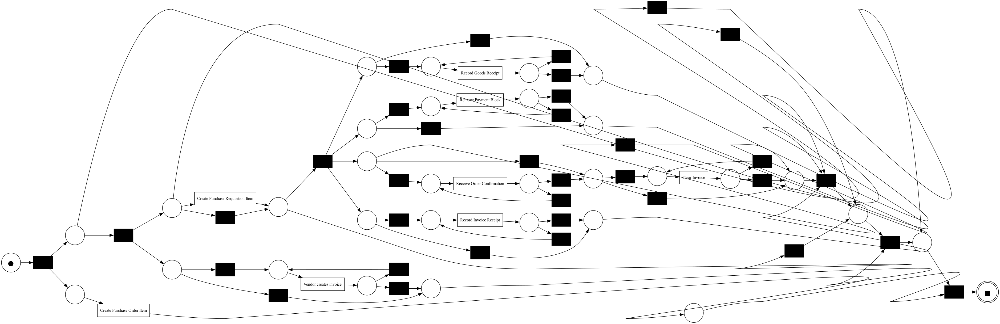

Skipping token-based replay fitness for Cluster 1 due to resource constraints.

=== [Cluster 2] PO='Consignment' SRM='NO_SRM' ITEM='Consignment' | #traces=14498 ===
Extracting sublog for Cluster 2 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 3 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 2...


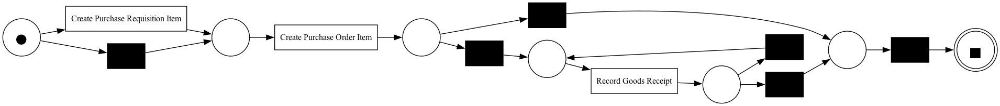

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/21 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/25 [00:00<?, ?it/s]

Model precision: 1.000
Counting nodes and edges in the Petri net...
Petri net structure: 7 places, 9 transitions, 18 arcs

=== [Cluster 3] PO='3-way match, invoice after GR' SRM='NO_SRM' ITEM='Standard' | #traces=8230 ===
Extracting sublog for Cluster 3 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 8 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 3...


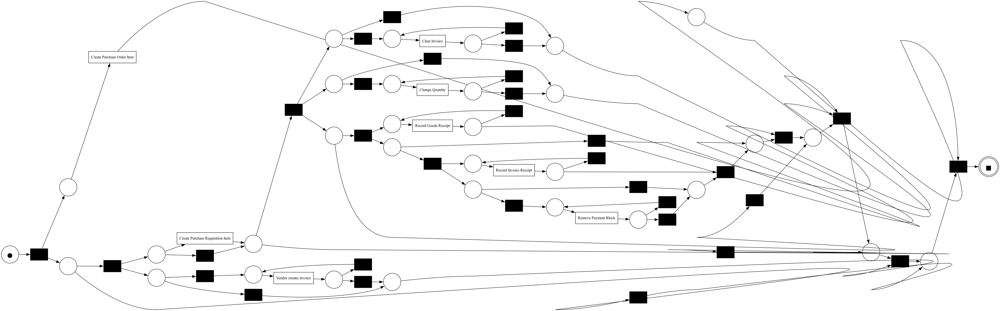

Skipping token-based replay fitness for Cluster 3 due to resource constraints.

=== [Cluster 4] PO='3-way match, invoice after GR' SRM='NO_SRM' ITEM='Service' | #traces=5341 ===
Extracting sublog for Cluster 4 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 6 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 4...


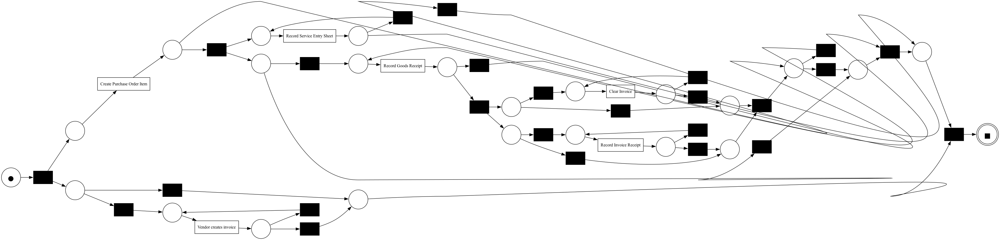

Skipping token-based replay fitness for Cluster 4 due to resource constraints.

=== [Cluster 5] PO='3-way match, invoice before GR' SRM='NO_SRM' ITEM='Third-party' | #traces=5106 ===
Extracting sublog for Cluster 5 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 7 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 5...


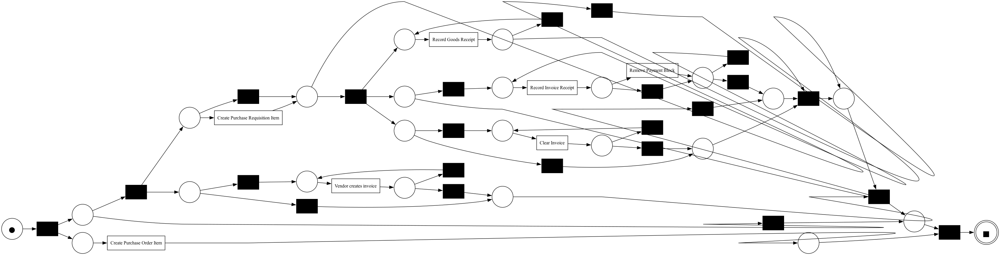

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/119 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/211 [00:00<?, ?it/s]

Model precision: 0.602
Counting nodes and edges in the Petri net...
Petri net structure: 24 places, 30 transitions, 68 arcs

=== [Cluster 6] PO='3-way match, invoice before GR' SRM='NO_SRM' ITEM='Subcontracting' | #traces=4062 ===
Extracting sublog for Cluster 6 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 8 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 6...


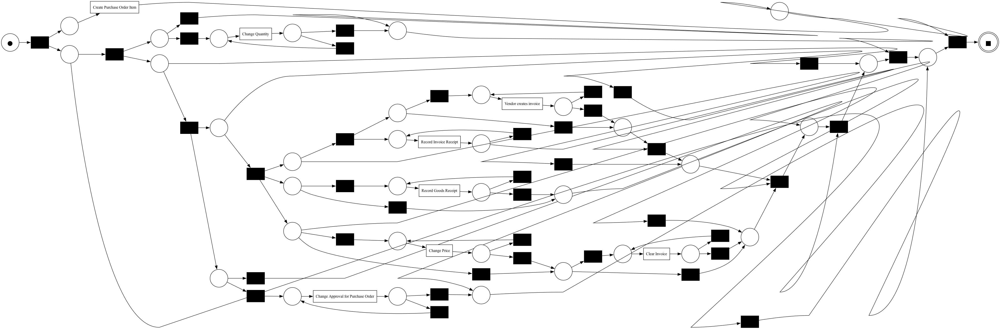

Skipping token-based replay fitness for Cluster 6 due to resource constraints.

=== [Cluster 7] PO='2-way match' SRM='NO_SRM' ITEM='Limit' | #traces=1044 ===
Extracting sublog for Cluster 7 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 5 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 7...


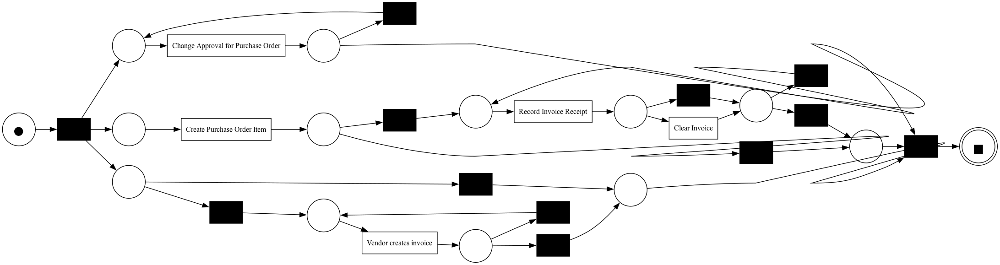

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/135 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/433 [00:00<?, ?it/s]

Model precision: 0.654
Counting nodes and edges in the Petri net...
Petri net structure: 14 places, 17 transitions, 38 arcs

=== [Cluster 8] PO='3-way match, invoice before GR' SRM='SRM' ITEM='Standard' | #traces=829 ===
Extracting sublog for Cluster 8 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 13 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 8...


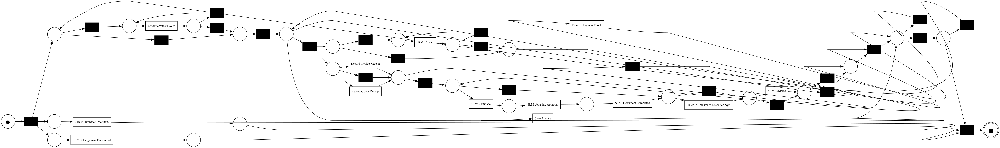

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/117 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/388 [00:00<?, ?it/s]

Model precision: 0.230
Counting nodes and edges in the Petri net...
Petri net structure: 26 places, 37 transitions, 80 arcs

=== [Cluster 9] PO='3-way match, invoice after GR' SRM='NO_SRM' ITEM='Subcontracting' | #traces=616 ===
Extracting sublog for Cluster 9 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 3 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 9...


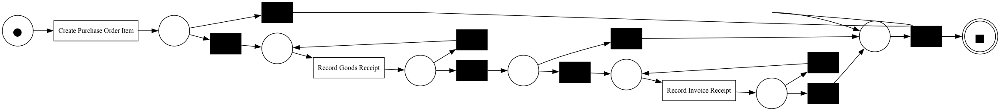

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/6 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

Model precision: 0.996
Counting nodes and edges in the Petri net...
Petri net structure: 9 places, 12 transitions, 24 arcs

=== [Cluster 10] PO='3-way match, invoice after GR' SRM='SRM' ITEM='Service' | #traces=497 ===
Extracting sublog for Cluster 10 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 15 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 10...


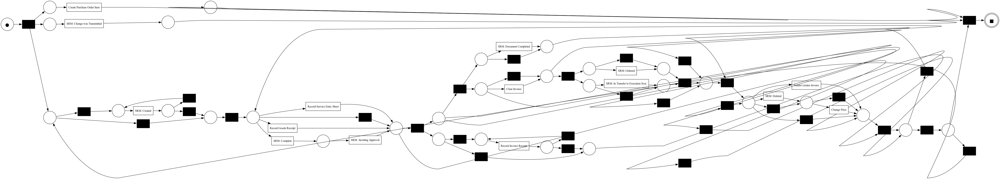

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/229 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/4354 [00:00<?, ?it/s]

Model precision: 0.148
Counting nodes and edges in the Petri net...
Petri net structure: 32 places, 48 transitions, 106 arcs

=== [Cluster 11] PO='3-way match, invoice after GR' SRM='NO_SRM' ITEM='Third-party' | #traces=384 ===
Extracting sublog for Cluster 11 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 6 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 11...


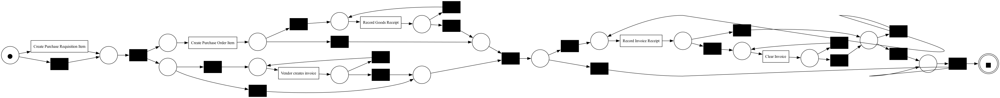

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/19 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/42 [00:00<?, ?it/s]

Model precision: 0.780
Counting nodes and edges in the Petri net...
Petri net structure: 19 places, 26 transitions, 54 arcs

=== [Cluster 12] PO='3-way match, invoice after GR' SRM='SRM' ITEM='Standard' | #traces=114 ===
Extracting sublog for Cluster 12 using selected trace indices...
Filtering out low-frequency activities (<10% of traces)...
Retained 12 frequent activities after filtering.
Discovering process model using Inductive Miner (noise_threshold=0.2)...
Visualizing discovered Petri net for Cluster 12...


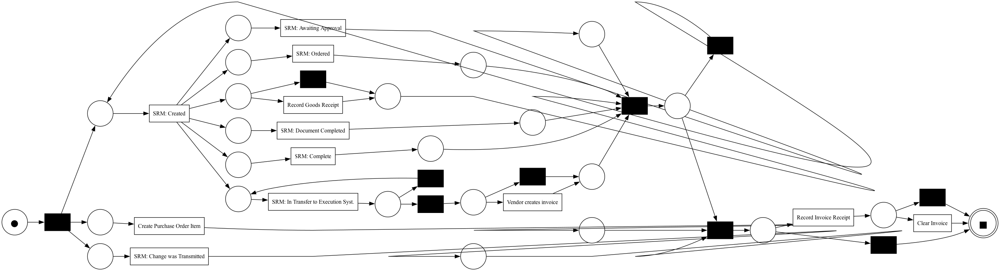

Performing token-based replay for fitness computation...


replaying log with TBR, completed traces ::   0%|          | 0/22 [00:00<?, ?it/s]

Average trace fitness: 1.000
Calculating precision of the model...


computing precision with alignments, completed variants ::   0%|          | 0/85 [00:00<?, ?it/s]

Model precision: 0.348
Counting nodes and edges in the Petri net...
Petri net structure: 24 places, 22 transitions, 58 arcs


In [88]:
summary_rows = []

for cluster_i, (cluster_key, trace_indices) in enumerate(selected_clusters, start=1):
    po_val, srm_flag, it_val = cluster_key
    print(f"\n=== [Cluster {cluster_i}] PO='{po_val}' SRM='{srm_flag}' ITEM='{it_val}' | #traces={len(trace_indices)} ===")

    print(f"Extracting sublog for Cluster {cluster_i} using selected trace indices...")
    sublog = build_sublog_from_indices(trace_indices)
    
    print(f"Filtering out low-frequency activities (<{int(ACTIVITY_FREQ_THRESHOLD * 100)}% of traces)...")
    filtered_log, kept_activities = drop_low_freq_activities(sublog, threshold_frac=ACTIVITY_FREQ_THRESHOLD)
    print(f"Retained {len(kept_activities)} frequent activities after filtering.")

    print(f"Discovering process model using Inductive Miner (noise_threshold={NOISE_THRESHOLD})...")
    params = {"noise_threshold": NOISE_THRESHOLD}
    tree = inductive_miner.apply(filtered_log, parameters=params)
    
    net, im, fm = pt_converter.apply(tree)

    print(f"Visualizing discovered Petri net for Cluster {cluster_i}...")
    gviz = pn_visualizer.apply(net, im, fm)
    pn_visualizer.view(gviz)

  
    # for performance
    if cluster_i in [1, 4, 6, 3]:
        print(f"Skipping token-based replay fitness for Cluster {cluster_i} due to resource constraints.")
        continue

    print(f"Performing token-based replay for fitness computation...")
    replay_res = token_replay.apply(filtered_log, net, im, fm) # checks how many tokens consumed/produced + whether model can replay trace correctly.

    fitness_list = []
    for r in replay_res:
        fitness_list.append(r["trace_fitness"])
    
    avg_fitness = float(np.mean(fitness_list)) if fitness_list else np.nan
    print(f"Average trace fitness: {avg_fitness:.3f}")

    print(f"Calculating precision of the model...")
    prec = precision_evaluator.apply(filtered_log, net, im, fm) #Describes how closely the model matches observed behavior without overgeneralizing
    precision_value = float(prec)
    print(f"Model precision: {precision_value:.3f}")

    print(f"Counting nodes and edges in the Petri net...")
    n_places = len(net.places)
    n_transitions = len(net.transitions)
    n_arcs = len(net.arcs)
    node_count = n_places + n_transitions
    edge_count = n_arcs
    print(f"Petri net structure: {n_places} places, {n_transitions} transitions, {n_arcs} arcs")

    summary_rows.append({
        "cluster_index": cluster_i,
        "po_value": po_val,
        "srm_flag": srm_flag,
        "item_value": it_val,
        "n_traces": len(trace_indices),
        "n_traces_after_activity_filter": len(filtered_log),
        "avg_fitness": avg_fitness,
        "precision": precision_value,
        "node_count": node_count,
        "edge_count": edge_count
    })



In [89]:
summary_df = pd.DataFrame(summary_rows)
summary_df = summary_df.sort_values("n_traces", ascending=False).reset_index(drop=True)
display(summary_df)

,cluster_index,po_value,srm_flag,item_value,n_traces,n_traces_after_activity_filter,avg_fitness,precision,node_count,edge_count
0,2,Consignment,NO_SRM,Consignment,14498,14498,1.000000,1.000000,16,18
1,5,"3-way match, invoice before GR",NO_SRM,Third-party,5106,5106,1.000000,0.601661,54,68
2,7,2-way match,NO_SRM,Limit,1044,1044,1.000000,0.653903,31,38
3,8,"3-way match, invoice before GR",SRM,Standard,829,829,1.000000,0.230291,63,80
4,9,"3-way match, invoice after GR",NO_SRM,Subcontracting,616,616,1.000000,0.995724,21,24
5,10,"3-way match, invoice after GR",SRM,Service,497,497,0.999798,0.147588,80,106
6,11,"3-way match, invoice after GR",NO_SRM,Third-party,384,384,1.000000,0.780473,45,54
7,12,"3-way match, invoice after GR",SRM,Standard,114,114,1.000000,0.347991,46,58


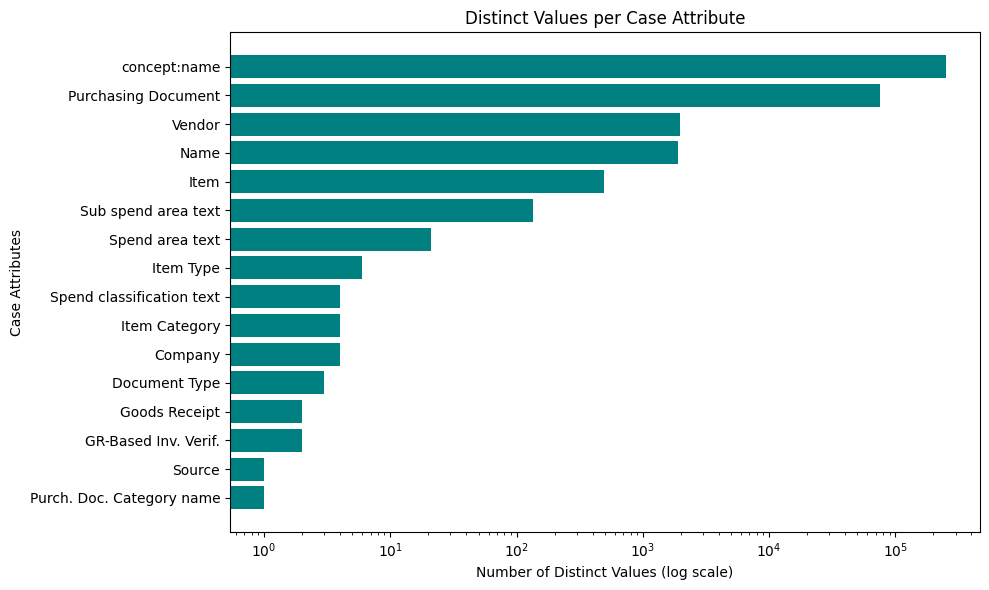

,case_attribute,distinct_values
5,Purch. Doc. Category name,1
10,Source,1
12,GR-Based Inv. Verif.,2
15,Goods Receipt,2
2,Document Type,3
1,Company,4
8,Item Category,4
9,Spend classification text,4
7,Item Type,6
0,Spend area text,21


In [92]:
import pandas as pd
import matplotlib.pyplot as plt
from pm4py.statistics.attributes.log import get as attr_get

case_attr_keys = list(log[0].attributes.keys())

distinct_counts = {}
for key in case_attr_keys:
    values = set()
    for trace in log:
        if key in trace.attributes:
            values.add(trace.attributes[key])
    distinct_counts[key] = len(values)

df_attrs = pd.DataFrame(list(distinct_counts.items()), columns=["case_attribute", "distinct_values"])
df_attrs = df_attrs.sort_values("distinct_values", ascending=True)

# Plot dynamically
plt.figure(figsize=(10,6))
plt.barh(df_attrs["case_attribute"], df_attrs["distinct_values"], color="teal")
plt.xscale("log")
plt.xlabel("Number of Distinct Values (log scale)")
plt.ylabel("Case Attributes")
plt.title("Distinct Values per Case Attribute")
plt.tight_layout()
plt.show()

df_attrs.head(20)


In [93]:
#section 5 of student paper - scikit learn

## Analysis of process deviating purchase order items

## 5. Analysis Overview
- Event log analyzed for compliance and deviations in PO items  
- Additional dimensions proposed for classifiers to detect incompliance  
- Rework activities identified (subsection 5.1)  
- Classifiers built to interpret influencing factors on compliance  

---

## 5.1 Additional Dimensions
- **Purpose:** Analyze parameters influencing case compliance/incompliance  
- **Levels:**  
  - *Case level* – full process insights  
  - *Event level* – insights based on timestamped events  

### Dimensions:
- **Number of handovers:**  
  - Case: count of distinct users (excluding “batch_user”, “NONE”)  
  - Event: sequence of user handovers per event  

- **Count of rework activities:**  
  - Identify activities with “change”, “cancel”, “delete” in name  
  - Boolean indicator `is_rework` summed per case/event  

- **Segregation of Duty (SOD):**  
  - Flags true if same user created PO and recorded GR or IR  
  - Indicates lack of SOD(Segregation of Duties)

- **Retrospective PO items:**  
  - Boolean true if goods receipt/invoice logged before PO creation  
  - Indicates deviation from standard process  

- **Resource workload:**  
  - Work done by user in past 2 and 7 days  
  - Aggregated as average/max workload per case  

- **Create Order net value:**  
  - Total worth of PO  

- **Throughput time:**  
  - Time from PO creation to last event (in days)  

- **Material count:**  
  - Number of different sub_spend_area_text groups in PO  

- **Missing material:**  
  - Boolean true if sub_spend_area_text missing  
  - Indicates missing master data, higher risk of wrong entries  

- **Process cluster:**  
  - Grouping of cases by event pattern  

- **Orders per vendor/day:**  
  - Count of orders placed on same day for same vendor  

In [264]:
df = log_converter.apply(log, variant=log_converter.Variants.TO_DATA_FRAME)
df['time:timestamp'] = pd.to_datetime(df['time:timestamp'])

In [296]:
df['time:timestamp'].min(), df['time:timestamp'].max()

(Timestamp('2019-01-01 01:04:00+0000', tz='UTC'),
 Timestamp('2019-12-05 22:59:00+0000', tz='UTC'))

In [ ]:
df = df[(df['time:timestamp'] >= '2019-01-01') & (df['time:timestamp'] < '2020-01-01')]
df.sort_values(['case:concept:name', 'time:timestamp'], inplace=True)

In [297]:
df.head()

,User,org:resource,concept:name,Cumulative net worth (EUR),time:timestamp,case:Spend area text,case:Company,case:Document Type,case:Sub spend area text,case:Purchasing Document,...,case:Spend classification text,case:Source,case:Name,case:GR-Based Inv. Verif.,case:Item,case:concept:name,case:Goods Receipt,is_rework_activity,create_date,orders_same_day_vendor
0,user_003,user_003,SRM: In Transfer to Execution Syst.,557.0,2019-01-17 10:58:00+00:00,Marketing,companyID_0000,EC Purchase order,Marketing Support Services,2000000001,...,NPR,sourceSystemID_0000,vendor_0001,True,00001,2000000001_00001,True,False,2019-01-17,NaN
1,user_003,user_003,SRM: Transfer Failed (E.Sys.),557.0,2019-01-17 10:58:00+00:00,Marketing,companyID_0000,EC Purchase order,Marketing Support Services,2000000001,...,NPR,sourceSystemID_0000,vendor_0001,True,00001,2000000001_00001,True,False,2019-01-17,NaN
2,user_003,user_003,SRM: In Transfer to Execution Syst.,76210.0,2019-01-17 10:59:00+00:00,Marketing,companyID_0000,EC Purchase order,Digital Marketing,2000000002,...,NPR,sourceSystemID_0000,vendor_0002,True,00001,2000000002_00001,True,False,2019-01-17,NaN
3,user_003,user_003,SRM: Transfer Failed (E.Sys.),76210.0,2019-01-17 10:59:00+00:00,Marketing,companyID_0000,EC Purchase order,Digital Marketing,2000000002,...,NPR,sourceSystemID_0000,vendor_0002,True,00001,2000000002_00001,True,False,2019-01-17,NaN
4,user_003,user_003,SRM: In Transfer to Execution Syst.,37819.0,2019-01-17 10:59:00+00:00,Marketing,companyID_0000,EC Purchase order,Advertising,2000000006,...,NPR,sourceSystemID_0000,vendor_0005,True,00001,2000000006_00001,True,False,2019-01-17,NaN


In [298]:
#unique users (excluding batch_user and NONE)
def count_handovers(case_df):
    users = case_df['org:resource'].dropna().unique()
    users = [u for u in users if u not in ['batch_user', 'NONE']]
    return len(users)

handovers = df.groupby('case:concept:name').apply(count_handovers, include_groups=False).reset_index(name='num_handovers')

In [299]:
handovers.head()

,case:concept:name,num_handovers
0,2000000001_00001,1
1,2000000002_00001,1
2,2000000006_00001,2
3,2000000010_00001,1
4,2000000011_00001,1


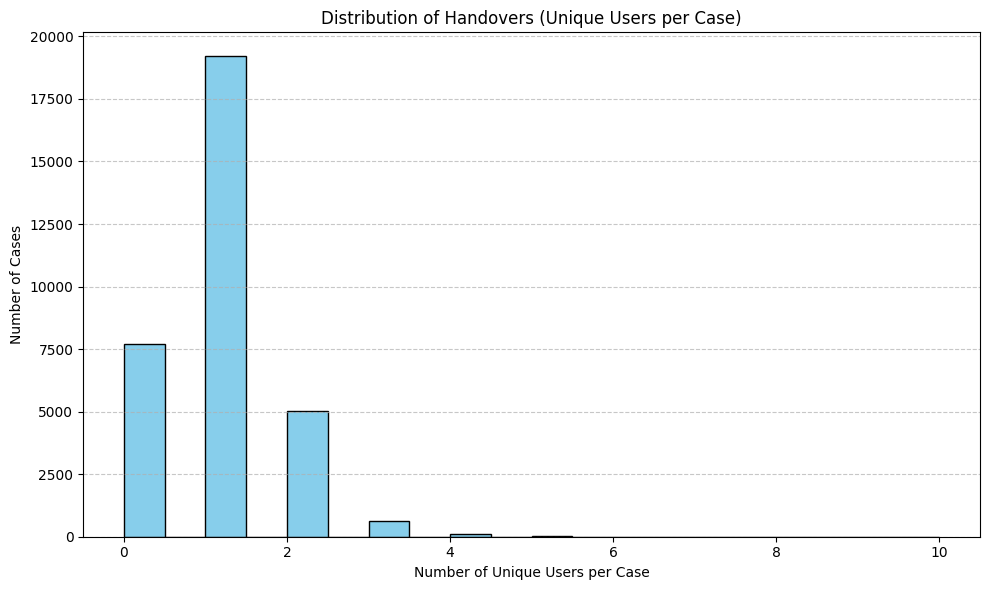

In [300]:

plt.figure(figsize=(10, 6))
plt.hist(handovers['num_handovers'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel("Number of Unique Users per Case")
plt.ylabel("Number of Cases")
plt.title("Distribution of Handovers (Unique Users per Case)")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [301]:
#unique users (excluding batch_user and NONE)
def count_handovers(case_df):
    users = case_df['org:resource'].dropna().unique()
    users = [u for u in users if u not in ['batch_user', 'NONE']]
    return len(users)

activity_handovers = df.groupby('concept:name').apply(count_handovers, include_groups=False).reset_index(name='num_handovers')

In [302]:
activity_handovers.sort_values("num_handovers", ascending=False).head(10)

,concept:name,num_handovers
14,Record Goods Receipt,108
7,Change Quantity,55
5,Change Delivery Indicator,35
6,Change Price,33
10,Create Purchase Order Item,30
11,Delete Purchase Order Item,28
1,Cancel Goods Receipt,23
15,Record Invoice Receipt,11
9,Clear Invoice,11
2,Cancel Invoice Receipt,9


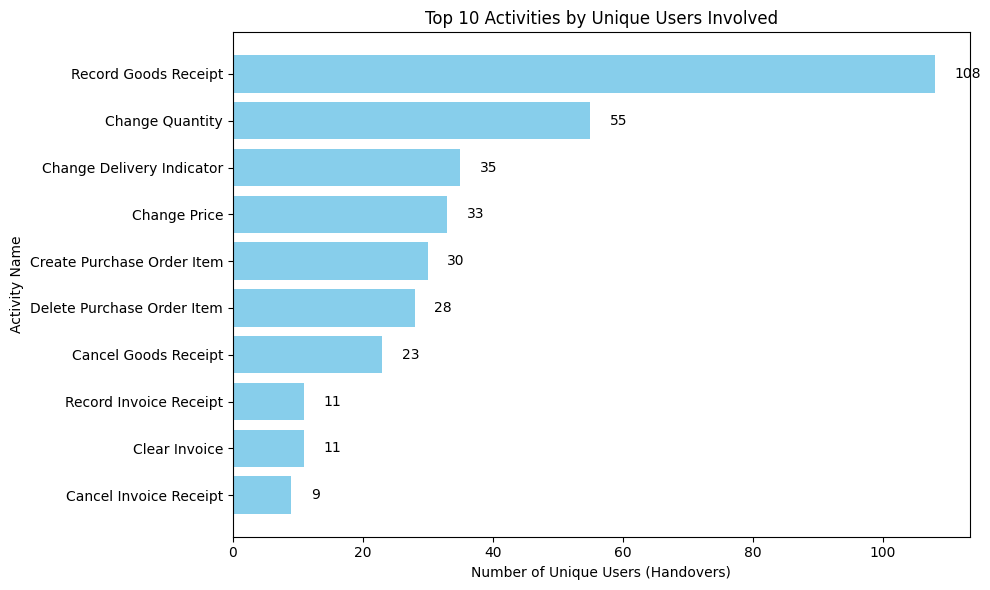

In [303]:
top_handovers = activity_handovers.sort_values("num_handovers", ascending=False).head(10)

plt.figure(figsize=(10, 6))
plt.barh(top_handovers['concept:name'], top_handovers['num_handovers'], color='skyblue')
plt.xlabel("Number of Unique Users (Handovers)")
plt.ylabel("Activity Name")
plt.title("Top 10 Activities by Unique Users Involved")
plt.gca().invert_yaxis()  #highest value is at the top

for i, v in enumerate(top_handovers['num_handovers']):
    plt.text(v + 3, i, str(v), va='center')

plt.tight_layout()
plt.show()

In [304]:
rework_keywords = ['change', 'cancel', 'delete']
df['is_rework_activity'] = df['concept:name'].str.lower().apply(lambda x: any(k in x for k in rework_keywords))
rework_counts = df.groupby('case:concept:name')['is_rework_activity'].sum().reset_index(name='rework_count')

In [305]:
rework_counts.head()

,case:concept:name,rework_count
0,2000000001_00001,0
1,2000000002_00001,0
2,2000000006_00001,1
3,2000000010_00001,0
4,2000000011_00001,0


In [306]:
rework_summary = (
    df[df['is_rework_activity']]
    .groupby('concept:name')
    .agg(num_cases=('case:concept:name', 'nunique'), num_events=('concept:name', 'count'))
    .reset_index()
    .sort_values(by='num_events', ascending=False)
)


In [307]:
rework_summary.head()

,concept:name,num_cases,num_events
3,Change Approval for Purchase Order,366,580
6,Change Quantity,469,525
1,Cancel Invoice Receipt,318,328
5,Change Price,227,234
8,Delete Purchase Order Item,177,177


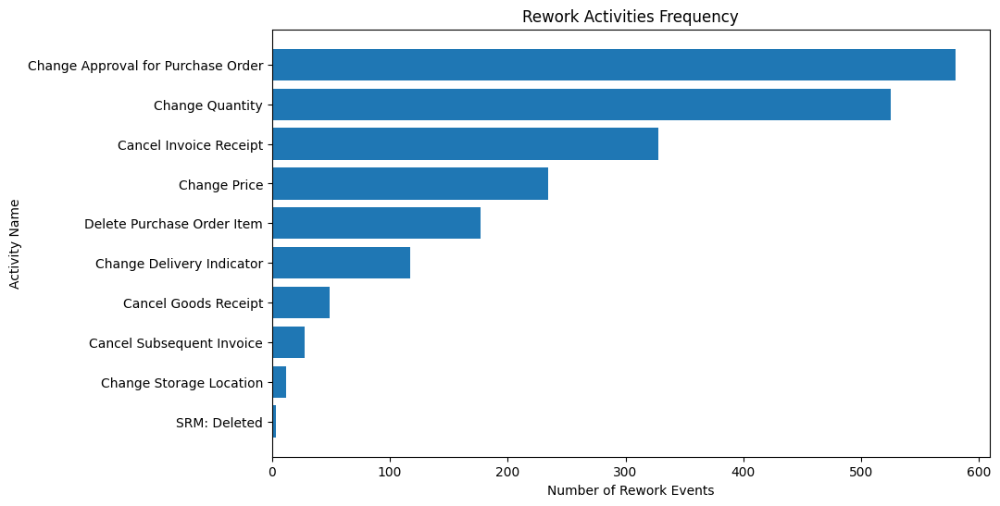

In [308]:
plt.figure(figsize=(10, 6))
plt.barh(rework_summary['concept:name'], rework_summary['num_events'])
plt.xlabel("Number of Rework Events")
plt.ylabel("Activity Name")
plt.title("Rework Activities Frequency")
plt.gca().invert_yaxis()
plt.show()

In [309]:
def sod_flags(case_df):
    create_user = case_df.loc[case_df['concept:name'].str.contains('Create', case=False), 'org:resource']
    gr_user = case_df.loc[case_df['concept:name'].str.contains('Goods Receipt', case=False), 'org:resource']
    ir_user = case_df.loc[case_df['concept:name'].str.contains('Invoice Receipt', case=False), 'org:resource']
    sod_poi_gr = not create_user.empty and not gr_user.empty and create_user.iloc[0] == gr_user.iloc[0]
    sod_poi_ir = not create_user.empty and not ir_user.empty and create_user.iloc[0] == ir_user.iloc[0]
    return pd.Series({'sod_create_gr': sod_poi_gr, 'sod_create_ir': sod_poi_ir})

sod = df.groupby('case:concept:name').apply(sod_flags, include_groups=False).reset_index()

In [310]:
sod.head()

,case:concept:name,sod_create_gr,sod_create_ir
0,2000000001_00001,False,False
1,2000000002_00001,False,False
2,2000000006_00001,False,False
3,2000000010_00001,False,False
4,2000000011_00001,False,False


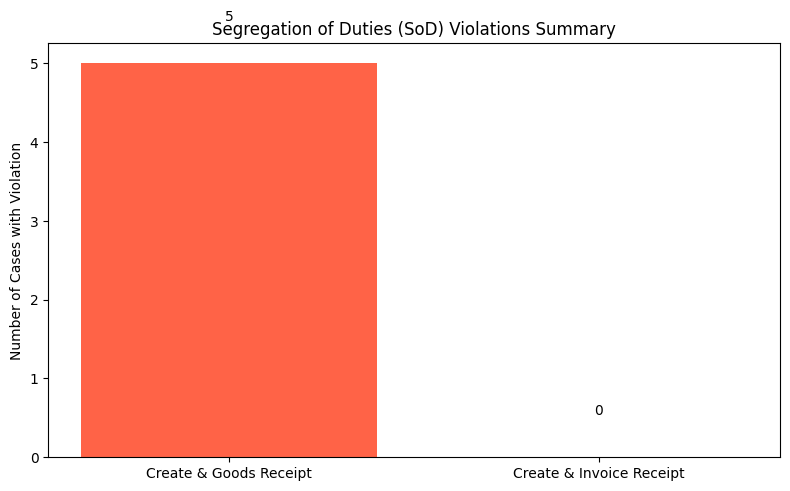

In [279]:
sod_summary = pd.DataFrame({
    'Violation Type': ['Create & Goods Receipt', 'Create & Invoice Receipt'],
    'Number of Cases': [sod['sod_create_gr'].sum(), sod['sod_create_ir'].sum()]
})

plt.figure(figsize=(8, 5))
plt.bar(sod_summary['Violation Type'], sod_summary['Number of Cases'], color=['tomato', 'steelblue'])
plt.ylabel("Number of Cases with Violation")
plt.title("Segregation of Duties (SoD) Violations Summary")

for i, v in enumerate(sod_summary['Number of Cases']):
    plt.text(i, v + 0.5, str(v), ha='center', va='bottom')

plt.tight_layout()
plt.show()

In [280]:
create_keywords = ['Create Purchase Order Item', 'Create Purchase Requisition Item', 'SRM: Created']
gr_keywords = ['Goods Receipt']
ir_keywords = ['Invoice Receipt']

In [281]:
def retrospective_flags(case_df):
    create_time = case_df.loc[case_df['concept:name'].str.contains('|'.join(create_keywords), case=False), 'time:timestamp']
    gr_time = case_df.loc[case_df['concept:name'].str.contains('|'.join(gr_keywords), case=False), 'time:timestamp']
    ir_time = case_df.loc[case_df['concept:name'].str.contains('|'.join(ir_keywords), case=False), 'time:timestamp']

    # If no creation event, but GR exists => retrospective
    if create_time.empty:
        return pd.Series({'is_retrospective': not gr_time.empty})

    c_time = create_time.min()
    retro_gr_before_create = (not gr_time.empty) and (gr_time.min() < c_time)

    # If GR exists, check if IR happened before GR
    retro_ir_before_gr = (not gr_time.empty) and (not ir_time.empty) and (ir_time.min() < gr_time.min())

    is_retro = retro_gr_before_create or retro_ir_before_gr
    return pd.Series({'is_retrospective': is_retro})

retrospective = df.groupby('case:concept:name').apply(retrospective_flags, include_groups=False).reset_index()

In [282]:
retrospective_counts = retrospective['is_retrospective'].value_counts()

print(retrospective_counts)

is_retrospective
False    25534
True      7146
Name: count, dtype: int64


In [283]:
retrospective.head(5)

,case:concept:name,is_retrospective
0,2000000001_00001,False
1,2000000002_00001,False
2,2000000006_00001,False
3,2000000010_00001,False
4,2000000011_00001,False


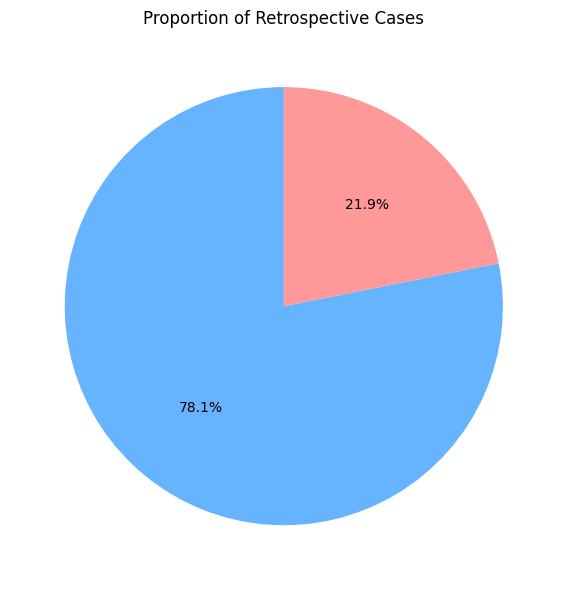

In [284]:
retro_percent = retrospective['is_retrospective'].value_counts(normalize=True) * 100

plt.figure(figsize=(6, 6))
plt.pie(
    retro_percent,
    # labels=['Non-Retrospective', 'Retrospective'],
    autopct='%1.1f%%',
    startangle=90,
    colors=['#66b3ff', '#ff9999']
)
plt.title("Proportion of Retrospective Cases")
plt.tight_layout()
plt.show()

In [311]:
def compute_workload_for_timestamp(times, t, window_days):
    """
    Count how many events in 'times' occurred within the past 'window_days' days
    (excluding the current event at time 't').
    """
    window_start = t - pd.Timedelta(days=window_days)
    mask = (times < t) & (times >= window_start)
    return mask.sum()


df['workload_2d'] = 0
df['workload_7d'] = 0

# Compute workloads per resource using rolling windows
for resource, group in df.groupby('org:resource', group_keys=False):
    times = group['time:timestamp']
    workload_2d = times.apply(lambda t: compute_workload_for_timestamp(times, t, 2))
    workload_7d = times.apply(lambda t: compute_workload_for_timestamp(times, t, 7))
    df.loc[group.index, 'workload_2d'] = workload_2d
    df.loc[group.index, 'workload_7d'] = workload_7d

In [312]:
# case level aggregation
workload_case = df.groupby('case:concept:name')[['workload_2d', 'workload_7d']].agg(['mean', 'max'])
workload_case.columns = ['workload_2d_mean', 'workload_2d_max', 'workload_7d_mean', 'workload_7d_max']
workload_case = workload_case.reset_index()

In [313]:
workload_case.head()

,case:concept:name,workload_2d_mean,workload_2d_max,workload_7d_mean,workload_7d_max
0,2000000001_00001,0.0,0,0.0,0
1,2000000002_00001,2.0,2,2.0,2
2,2000000006_00001,4.0,6,10.5,19
3,2000000010_00001,2.0,2,2.0,2
4,2000000011_00001,2.0,2,2.0,2


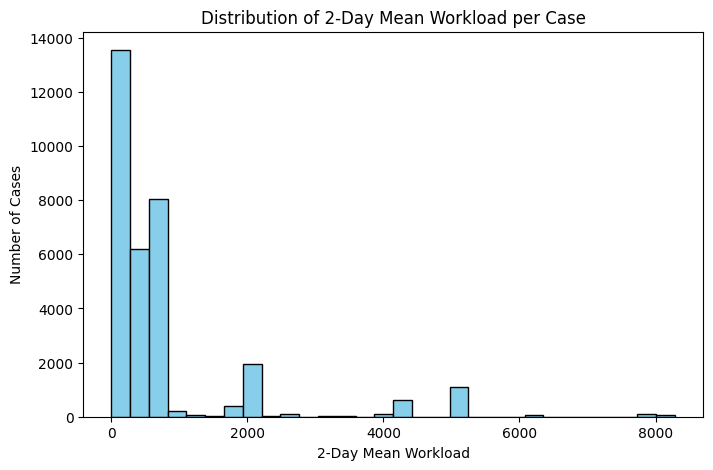

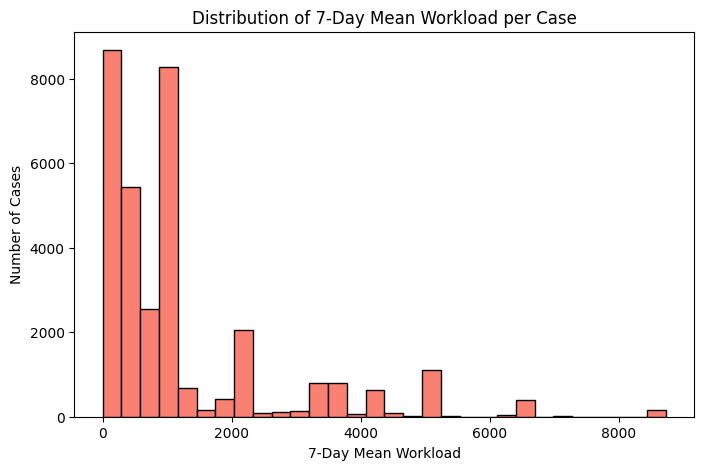

In [336]:
plt.figure(figsize=(8,5))
plt.hist(workload_case['workload_2d_mean'], bins=30, color='skyblue', edgecolor='black')
plt.title("Distribution of 2-Day Mean Workload per Case")
plt.xlabel("2-Day Mean Workload")
plt.ylabel("Number of Cases")
plt.show()

plt.figure(figsize=(8,5))
plt.hist(workload_case['workload_7d_mean'], bins=30, color='salmon', edgecolor='black')
plt.title("Distribution of 7-Day Mean Workload per Case")
plt.xlabel("7-Day Mean Workload")
plt.ylabel("Number of Cases")
plt.show()


In [314]:
throughput = df.groupby('case:concept:name')['time:timestamp'].agg(['min', 'max']).reset_index()
throughput['throughput_days'] = (throughput['max'] - throughput['min']).dt.days
throughput = throughput[['case:concept:name', 'throughput_days']]

In [315]:
# df_2019 = df[(df['time:timestamp'] >= '2019-01-01') & (df['time:timestamp'] < '2020-01-01')]
# throughput = df_2019.groupby('case:concept:name')['time:timestamp'].agg(['min', 'max']).reset_index()
# throughput['throughput_days'] = (throughput['max'] - throughput['min']).dt.days
# throughput = throughput[['case:concept:name', 'throughput_days']]
# throughput.sort_values("throughput_days", ascending=False).head(10)

In [316]:
throughput.head()

,case:concept:name,throughput_days
0,2000000001_00001,0
1,2000000002_00001,0
2,2000000006_00001,0
3,2000000010_00001,0
4,2000000011_00001,0


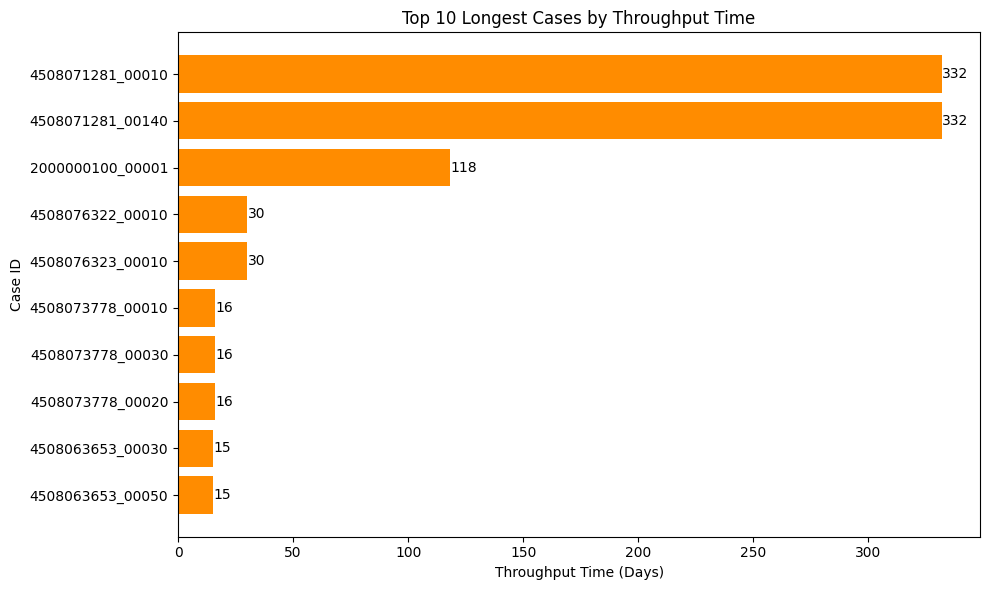

In [317]:
top_cases = throughput.sort_values("throughput_days", ascending=False).head(10)

plt.figure(figsize=(10, 6))
plt.barh(top_cases['case:concept:name'], top_cases['throughput_days'], color='darkorange')
plt.xlabel("Throughput Time (Days)")
plt.ylabel("Case ID")
plt.title("Top 10 Longest Cases by Throughput Time")
plt.gca().invert_yaxis()

for i, v in enumerate(top_cases['throughput_days']):
    plt.text(v + 0.2, i, str(v), va='center')

plt.tight_layout()
plt.show()

In [318]:
net_value = df.groupby('case:concept:name')['Cumulative net worth (EUR)'].max().reset_index(name='net_value')

In [319]:
net_value.head()

,case:concept:name,net_value
0,2000000001_00001,557.0
1,2000000002_00001,76210.0
2,2000000006_00001,37819.0
3,2000000010_00001,1668264.0
4,2000000011_00001,112583.0


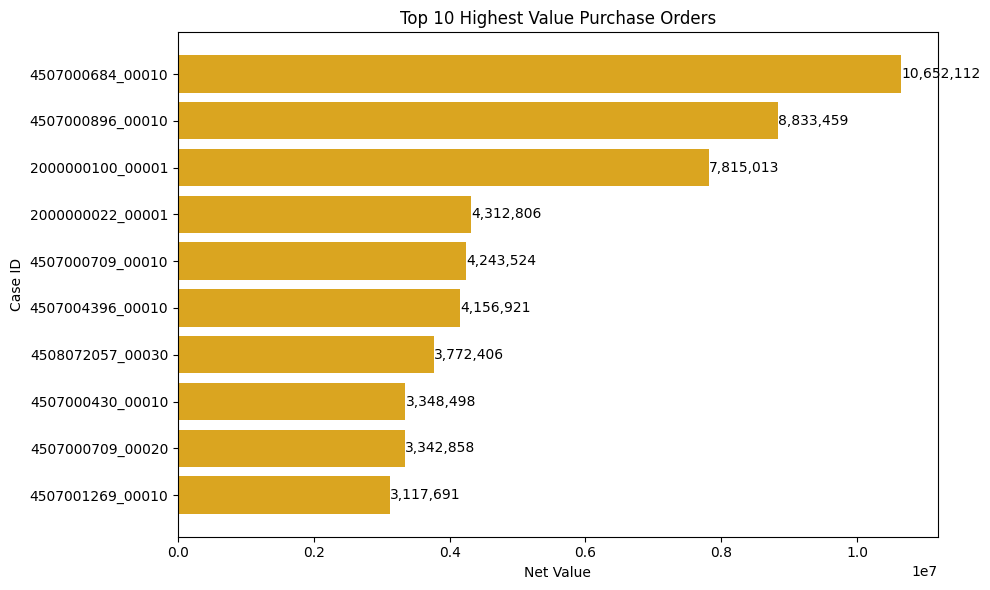

In [320]:
top_net_value = net_value.sort_values("net_value", ascending=False).head(10)

plt.figure(figsize=(10, 6))
plt.barh(top_net_value['case:concept:name'], top_net_value['net_value'], color='goldenrod')
plt.xlabel("Net Value")
plt.ylabel("Case ID")
plt.title("Top 10 Highest Value Purchase Orders")
plt.gca().invert_yaxis()

for i, v in enumerate(top_net_value['net_value']):
    plt.text(v + 1000, i, f"{v:,.0f}", va='center')

plt.tight_layout()
plt.show()

In [321]:
(df["case:Sub spend area text"].value_counts()).head(10)

case:Sub spend area text
Products for Resale                 9557
Labels                              8637
Trading products (old structure)    3847
Metal Containers & Lids < 30L       3651
Plastic Containers & Lids < 30L     3156
Packaging - Other                   2360
                                    1945
Road Packed                         1307
Extenders                           1196
Color Collateral                     441
Name: count, dtype: int64

In [322]:
material_count = (
    df.groupby('case:Purchasing Document')['case:Sub spend area text']
      .nunique()
      .reset_index(name='material_count')
)

material_count = df[['case:concept:name', 'case:Purchasing Document']].merge(
    material_count,
    on='case:Purchasing Document',
    how='left'
)[['case:concept:name', 'material_count']]

In [323]:
m_counts = material_count['material_count'].value_counts()

print(m_counts)

material_count
1    34676
2     8751
3     1560
4      114
5       34
Name: count, dtype: int64


In [324]:
material_count.head()

,case:concept:name,material_count
0,2000000001_00001,1
1,2000000001_00001,1
2,2000000002_00001,1
3,2000000002_00001,1
4,2000000006_00001,1


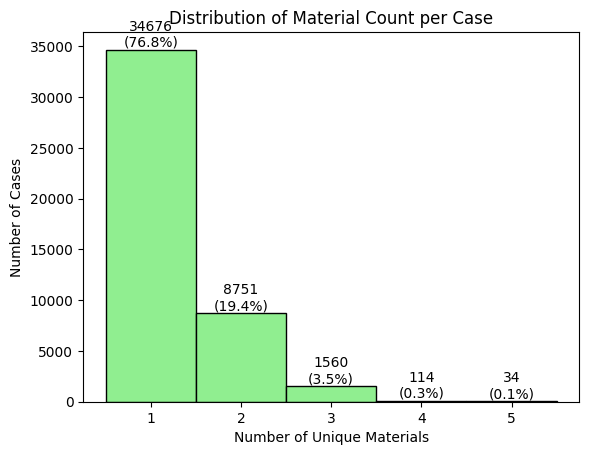

In [339]:
counts, bins, patches = plt.hist(
    material_count['material_count'],
    bins=range(1, material_count['material_count'].max() + 2),
    color='lightgreen',
    edgecolor='black',
    align='left'
)

plt.title("Distribution of Material Count per Case")
plt.xlabel("Number of Unique Materials")
plt.ylabel("Number of Cases")
plt.xticks(range(1, material_count['material_count'].max() + 1))

total = counts.sum()
for count, bin_edge, patch in zip(counts, bins, patches):
    if count > 0:
        plt.text(
            patch.get_x() + patch.get_width() / 2,  # x position (center of bar)
            count + 1,  # y position slightly above bar
            f"{int(count)}\n({count/total*100:.1f}%)",  # text: count and %
            ha='center',
            va='bottom'
        )

plt.show()

In [325]:
missing_material = (
    df.groupby('case:concept:name')['case:Sub spend area text']
      .apply(lambda x: x.isna().any() or (x == '').any())
      .reset_index(name='missing_material')
)

In [326]:
missing_material_counts = missing_material['missing_material'].value_counts()
print(missing_material_counts)

missing_material
False    31736
True       944
Name: count, dtype: int64


In [327]:
missing_material.head()

,case:concept:name,missing_material
0,2000000001_00001,False
1,2000000002_00001,False
2,2000000006_00001,False
3,2000000010_00001,False
4,2000000011_00001,False


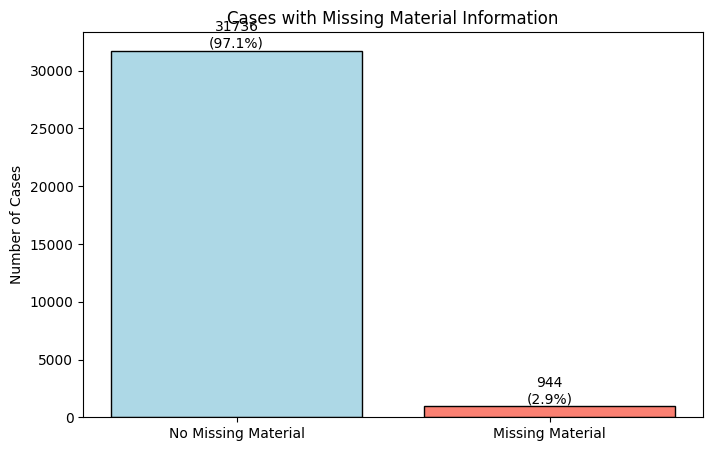

In [341]:
counts = missing_material['missing_material'].value_counts()
labels = ['No Missing Material', 'Missing Material']

plt.figure(figsize=(8,5))
bars = plt.bar(labels, counts, color=['lightblue', 'salmon'], edgecolor='black')

total = counts.sum()
for bar, count in zip(bars, counts):
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        count + 1,
        f"{count}\n({count/total*100:.1f}%)",
        ha='center',
        va='bottom'
    )

plt.title("Cases with Missing Material Information")
plt.ylabel("Number of Cases")
plt.show()

In [329]:
df['create_date'] = df['time:timestamp'].dt.date
same_day_orders = df[df['concept:name'].str.contains('Create', case=False)]

vendor_day_counts = same_day_orders.groupby(['case:Vendor', 'create_date']).size().reset_index(name='orders_same_day_vendor')

# merging back to cases
df = df.merge(vendor_day_counts, on=['case:Vendor', 'create_date'], how='left')
orders_same_day_case = df.groupby('case:concept:name')['orders_same_day_vendor'].max().reset_index()

In [330]:
orders_same_day_case.head()

,case:concept:name,orders_same_day_vendor
0,2000000001_00001,NaN
1,2000000002_00001,NaN
2,2000000006_00001,NaN
3,2000000010_00001,NaN
4,2000000011_00001,NaN


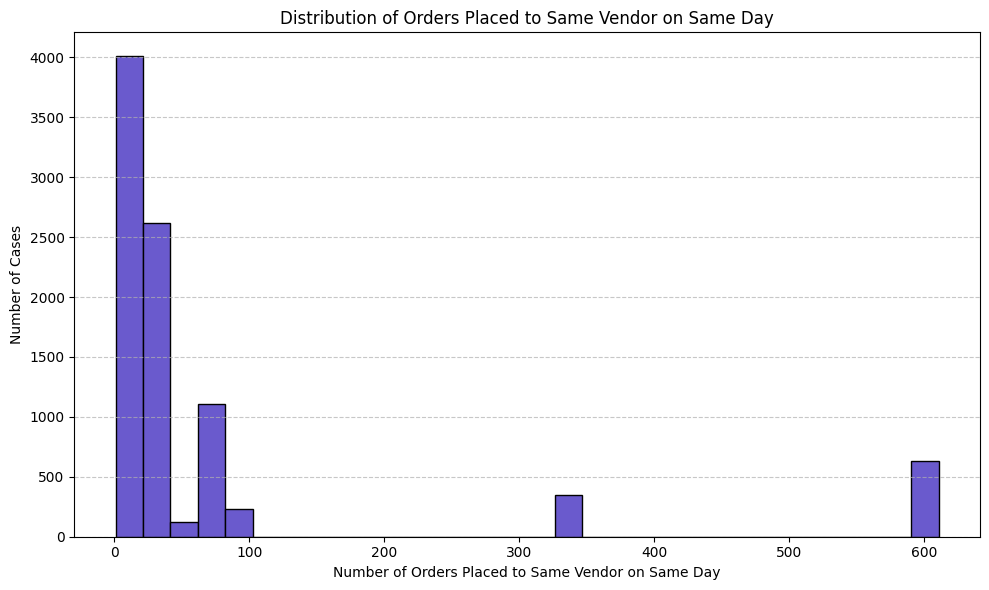

In [331]:
plt.figure(figsize=(10, 6))
plt.hist(orders_same_day_case['orders_same_day_vendor'].dropna(), bins=30, color='slateblue', edgecolor='black')
plt.xlabel("Number of Orders Placed to Same Vendor on Same Day")
plt.ylabel("Number of Cases")
plt.title("Distribution of Orders Placed to Same Vendor on Same Day")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [332]:
dfs_to_merge = [
    handovers, rework_counts, sod, retrospective,
    workload_case, throughput, net_value,
    material_count, missing_material, orders_same_day_case
]

case_features = reduce(lambda left, right: pd.merge(left, right, on='case:concept:name', how='outer'), dfs_to_merge)

In [333]:
case_features.head()

,case:concept:name,num_handovers,rework_count,sod_create_gr,sod_create_ir,is_retrospective,workload_2d_mean,workload_2d_max,workload_7d_mean,workload_7d_max,throughput_days,net_value,material_count,missing_material,orders_same_day_vendor
0,2000000001_00001,1,0,False,False,False,0.0,0,0.0,0,0,557.0,1,False,NaN
1,2000000001_00001,1,0,False,False,False,0.0,0,0.0,0,0,557.0,1,False,NaN
2,2000000002_00001,1,0,False,False,False,2.0,2,2.0,2,0,76210.0,1,False,NaN
3,2000000002_00001,1,0,False,False,False,2.0,2,2.0,2,0,76210.0,1,False,NaN
4,2000000006_00001,2,1,False,False,False,4.0,6,10.5,19,0,37819.0,1,False,NaN


In [334]:
case_dimensions = (
    handovers
    .merge(rework_counts, on='case:concept:name', how='left')
    .merge(sod, on='case:concept:name', how='left')
    .merge(retrospective, on='case:concept:name', how='left')
    .merge(throughput, on='case:concept:name', how='left')
)

In [335]:
case_dimensions.head()

,case:concept:name,num_handovers,rework_count,sod_create_gr,sod_create_ir,is_retrospective,throughput_days
0,2000000001_00001,1,0,False,False,False,0
1,2000000002_00001,1,0,False,False,False,0
2,2000000006_00001,2,1,False,False,False,0
3,2000000010_00001,1,0,False,False,False,0
4,2000000011_00001,1,0,False,False,False,0


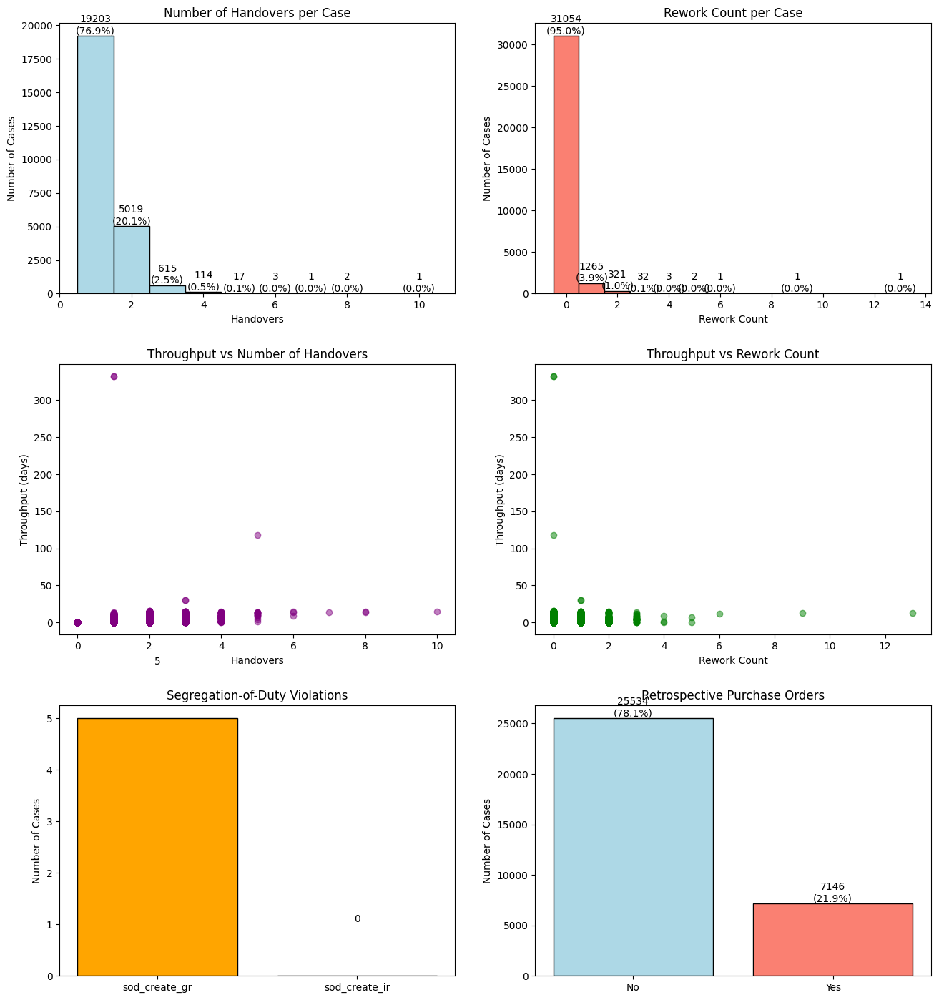

In [342]:
fig, axes = plt.subplots(3, 2, figsize=(14, 15))
fig.tight_layout(pad=5.0)

ax = axes[0,0]
counts, bins, patches = ax.hist(
    case_dimensions['num_handovers'],
    bins=range(1, case_dimensions['num_handovers'].max()+2),
    color='lightblue', edgecolor='black', align='left'
)
ax.set_title("Number of Handovers per Case")
ax.set_xlabel("Handovers")
ax.set_ylabel("Number of Cases")
total = counts.sum()
for count, patch in zip(counts, patches):
    if count>0:
        ax.text(patch.get_x()+patch.get_width()/2, count+1, f"{int(count)}\n({count/total*100:.1f}%)", ha='center', va='bottom')

ax = axes[0,1]
counts, bins, patches = ax.hist(
    case_dimensions['rework_count'],
    bins=range(0, case_dimensions['rework_count'].max()+2),
    color='salmon', edgecolor='black', align='left'
)
ax.set_title("Rework Count per Case")
ax.set_xlabel("Rework Count")
ax.set_ylabel("Number of Cases")
total = counts.sum()
for count, patch in zip(counts, patches):
    if count>0:
        ax.text(patch.get_x()+patch.get_width()/2, count+1, f"{int(count)}\n({count/total*100:.1f}%)", ha='center', va='bottom')

#Throughput vs Handovers
ax = axes[1,0]
ax.scatter(case_dimensions['num_handovers'], case_dimensions['throughput_days'], alpha=0.5, color='purple')
ax.set_title("Throughput vs Number of Handovers")
ax.set_xlabel("Handovers")
ax.set_ylabel("Throughput (days)")

#Throughput vs Rework
ax = axes[1,1]
ax.scatter(case_dimensions['rework_count'], case_dimensions['throughput_days'], alpha=0.5, color='green')
ax.set_title("Throughput vs Rework Count")
ax.set_xlabel("Rework Count")
ax.set_ylabel("Throughput (days)")

#SOD Violations
ax = axes[2,0]
sod_counts = case_dimensions[['sod_create_gr','sod_create_ir']].sum()
bars = ax.bar(sod_counts.index, sod_counts.values, color=['orange','red'], edgecolor='black')
ax.set_title("Segregation-of-Duty Violations")
ax.set_ylabel("Number of Cases")
for bar in bars:
    ax.text(bar.get_x()+bar.get_width()/2, bar.get_height()+1, str(int(bar.get_height())), ha='center', va='bottom')

#Retrospective PO Cases
ax = axes[2,1]
retro_counts = case_dimensions['is_retrospective'].value_counts()
labels = ['No', 'Yes']
bars = ax.bar(labels, retro_counts.values, color=['lightblue','salmon'], edgecolor='black')
ax.set_title("Retrospective Purchase Orders")
ax.set_ylabel("Number of Cases")
total = retro_counts.sum()
for bar, count in zip(bars, retro_counts.values):
    ax.text(bar.get_x()+bar.get_width()/2, count+1, f"{count}\n({count/total*100:.1f}%)", ha='center', va='bottom')

plt.show()


In [177]:
bool_cols = ['sod_create_gr', 'sod_create_ir', 'is_retrospective']
case_dimensions[bool_cols] = case_dimensions[bool_cols].astype(int)

In [191]:
case_dimensions['target'] = (case_dimensions['throughput_days'] > 10).astype(int)

In [192]:
#features
X = case_dimensions[['num_handovers', 'rework_count', 'sod_create_gr', 'sod_create_ir', 'is_retrospective', 'throughput_days']]
y = case_dimensions['target']

In [193]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=14)

In [194]:
dtc = DecisionTreeClassifier(max_depth=3, random_state=14)

In [195]:
dtc.fit(X_train, y_train)

,criterion,'gini'
,splitter,'best'
,max_depth,3
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,14
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,class_weight,None


In [196]:
y_pred = dtc.predict(X_test)

In [203]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     11366
           1       1.00      1.00      1.00    114501

    accuracy                           1.00    125867
   macro avg       1.00      1.00      1.00    125867
weighted avg       1.00      1.00      1.00    125867



In [198]:
tree_rules = export_text(dtc, feature_names=list(X.columns))

In [201]:
print(tree_rules)

|--- throughput_days <= 10.50
|   |--- class: 0
|--- throughput_days >  10.50
|   |--- class: 1

